#### 1. Title and Overview

# AI vs Human Art Classification
**Final Notebook – Comprehensive Version**

This notebook builds and evaluates multiple deep learning models to classify AI-generated versus human-created artwork. It includes a baseline model, custom CNNs, transfer learning, multi-class experiments, interpretability tools, and guidance for scaling.

### Sections 2-4: (Enviornment Setup, Data Loading and Configuration)

This section ensures reproducibility and loads all required packages. It sets the random seed across Python, NumPy, and TensorFlow to enforce consistent behavior across runs. Core libraries include TensorFlow/Keras for deep learning, Scikit-learn for metrics and data splitting, and Matplotlib/Seaborn for visualization.

#### 2. Environment Setup and Imports

In [2]:
# Upgrade pip, then install exact versions and supporting packages
%pip install -q --upgrade pip
%pip install -q \
    numpy==1.24.4 \
    tensorflow==2.15.0 \
    pillow \
    scikit-learn \
    matplotlib \
    seaborn \
    tqdm


Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [3]:
import os
import random
from pathlib import Path

import numpy as np
import matplotlib.pyplot as plt

# Core ML libraries
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks, optimizers, regularizers

# Data science tools
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.utils.class_weight import compute_class_weight

# Reproducibility
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)


2025-05-07 09:47:36.932042: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-05-07 09:47:36.932067: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-05-07 09:47:36.933202: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-05-07 09:47:36.937822: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-05-07 09:47:37.579685: W tensorflow/compiler/tf2

#### 3. GPU Configuration

In [4]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    for g in gpus:
        tf.config.experimental.set_memory_growth(g, True)
print('TensorFlow version:', tf.__version__)
print('GPUs available:', len(tf.config.list_physical_devices('GPU')))

TensorFlow version: 2.15.0
GPUs available: 1


2025-05-07 09:47:43.614343: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-05-07 09:47:43.672722: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-05-07 09:47:43.673000: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

#### 4. Dataset Directory & Class Names

In [5]:
DATA_DIR = Path.home() / 'Documents' / 'artwork-project' / 'notebooks' / 'data'
print('Looking in', DATA_DIR)

class_names = sorted([p.name for p in DATA_DIR.iterdir() if p.is_dir()])
print('Total style folders:', len(class_names))

Looking in /home/rohit/Documents/artwork-project/notebooks/data
Total style folders: 52


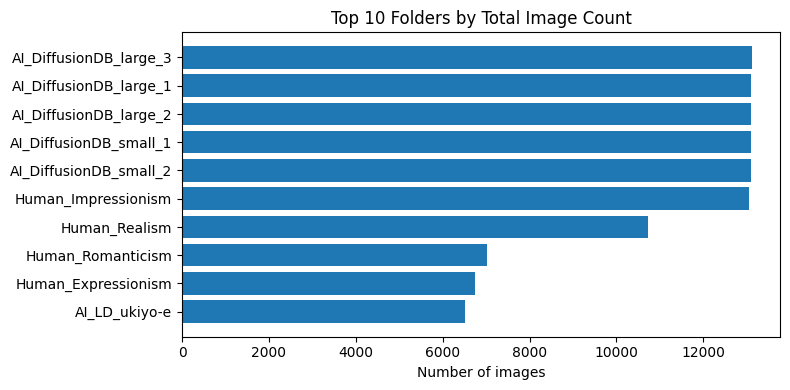

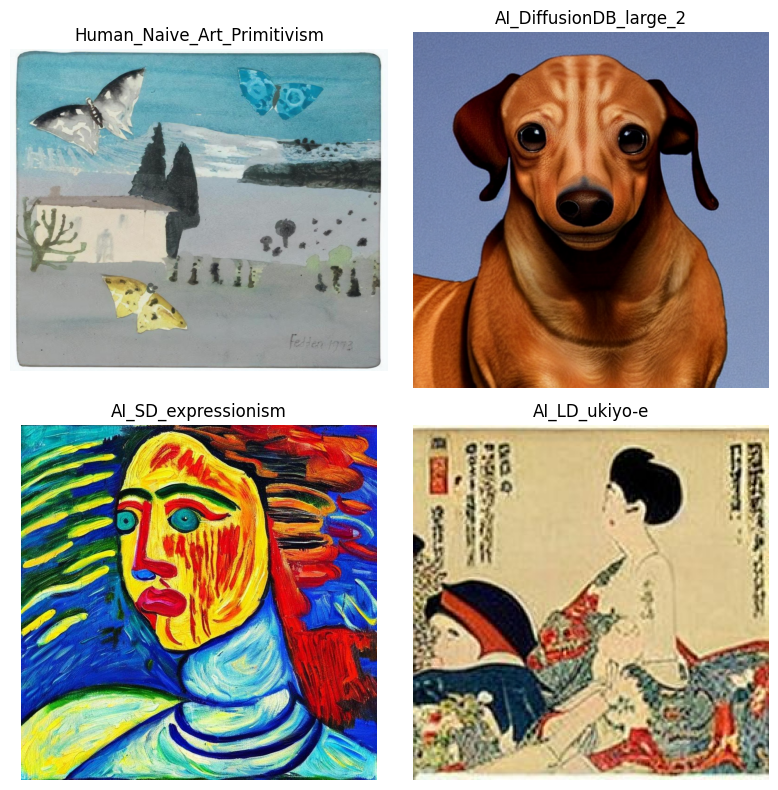

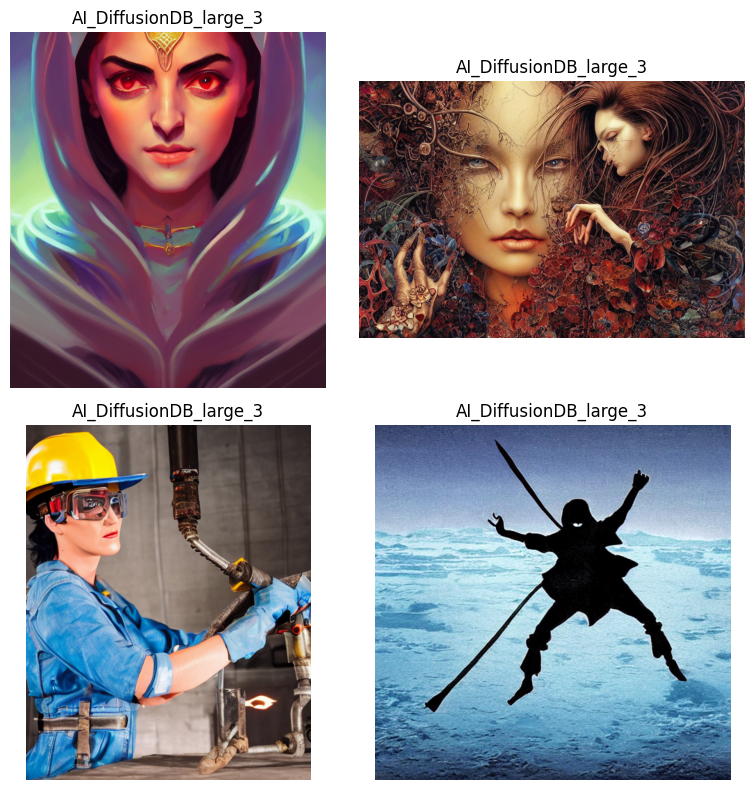

In [6]:
#### 4.1 (FIXED) Count images of any common extension per folder
EXTS = ("*.png","*.jpg","*.jpeg")

def count_all_images(folder: Path):
    return sum(len(list((folder).glob(ext))) for ext in EXTS)

counts = {c: count_all_images(DATA_DIR/c) for c in class_names}
top10 = dict(sorted(counts.items(), key=lambda kv: kv[1], reverse=True)[:10])

plt.figure(figsize=(8,4))
plt.barh(list(top10.keys())[::-1], list(top10.values())[::-1])
plt.title("Top 10 Folders by Total Image Count")
plt.xlabel("Number of images")
plt.tight_layout()
plt.show()

#### 4.2 (FIXED) Display random samples safely
# only pick from folders with at least one image
non_empty = [c for c,v in counts.items() if v>0]
plt.figure(figsize=(8,8))
for i in range(4):
    cname = random.choice(non_empty)
    # gather all extensions
    files = []
    for ext in EXTS:
        files += list((DATA_DIR/cname).glob(ext))
    img_path = random.choice(files)
    ax = plt.subplot(2,2,i+1)
    plt.imshow(plt.imread(img_path))
    plt.title(cname)
    plt.axis("off")
plt.tight_layout()
plt.show()


# 4.2 Display random samples from non-empty folders
valid_classes = [c for c in class_names if any((DATA_DIR/c).glob("*.png"))]

plt.figure(figsize=(8, 8))
for i in range(4):
    cname = random.choice(valid_classes)
    img_files = list((DATA_DIR/cname).glob("*.png"))
    img_path = random.choice(img_files)
    ax = plt.subplot(2, 2, i + 1)
    plt.imshow(plt.imread(img_path))
    plt.title(cname)
    plt.axis("off")
plt.tight_layout()
plt.show()


Smallest class size: 98 images
Largest  class size: 13110 images
Median   class size: 6056 images

Classes with < 500 images (5):
 ['Human_Action_Painting', 'Human_Analytical_Cubism', 'Human_Contemporary_Realism', 'Human_New_Realism', 'Human_Synthetic_Cubism']

Classes ≥ 500 images: 47 / 52 total


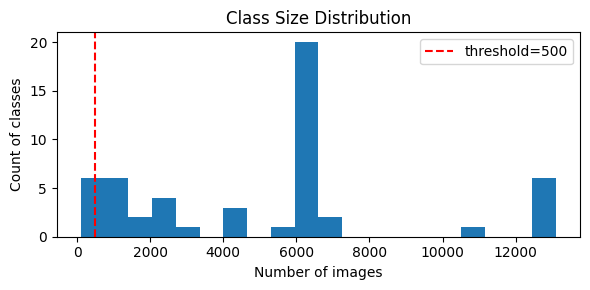

In [7]:
#### 4.3 Check Class Size Distribution & Thresholding

# compute min, max, median
all_counts = np.array(list(counts.values()))
print(f"Smallest class size: {all_counts.min()} images")
print(f"Largest  class size: {all_counts.max()} images")
print(f"Median   class size: {np.median(all_counts):.0f} images")

# list classes under some threshold, e.g. 500
THRESH = 500
tiny = [c for c,v in counts.items() if v < THRESH]
print(f"\nClasses with < {THRESH} images ({len(tiny)}):\n", tiny)

# how many would remain if we drop the tiny ones
keep = [c for c,v in counts.items() if v >= THRESH]
print(f"\nClasses ≥ {THRESH} images: {len(keep)} / {len(counts)} total")

# optionally show the distribution histogram
plt.figure(figsize=(6,3))
plt.hist(all_counts, bins=20)
plt.axvline(THRESH, color='r', linestyle='--', label=f'threshold={THRESH}')
plt.title("Class Size Distribution")
plt.xlabel("Number of images")
plt.ylabel("Count of classes")
plt.legend()
plt.tight_layout()
plt.show()

In [8]:
# ——— 4.4 Flat Multi‐Class Dataset Preparation ———

# 1) Select only the 47 “large” folders (≥500 images)
selected_classes = [
    'AI_DiffusionDB_large_1',   'AI_DiffusionDB_large_2',   'AI_DiffusionDB_large_3',
    'AI_DiffusionDB_small_1',   'AI_DiffusionDB_small_2',
    'AI_LD_art_nouveau',        'AI_LD_baroque',            'AI_LD_expressionism',
    'AI_LD_impressionism',      'AI_LD_post_impressionism', 'AI_LD_realism',
    'AI_LD_renaissance',        'AI_LD_romanticism',        'AI_LD_surrealism',
    'AI_LD_ukiyo-e',            'AI_SD_art_nouveau',        'AI_SD_baroque',
    'AI_SD_expressionism',      'AI_SD_impressionism',      'AI_SD_post_impressionism',
    'AI_SD_realism',            'AI_SD_renaissance',        'AI_SD_romanticism',
    'AI_SD_surrealism',         'AI_SD_ukiyo-e',
    'Human_Abstract_Expressionism', 'Human_Art_Nouveau_Modern', 'Human_Baroque',
    'Human_Color_Field_Painting',    'Human_Cubism',              'Human_Early_Renaissance',
    'Human_Expressionism',           'Human_Fauvism',             'Human_High_Renaissance',
    'Human_Impressionism',           'Human_Mannerism_Late_Renaissance',
    'Human_Minimalism',              'Human_Naive_Art_Primitivism','Human_Northern_Renaissance',
    'Human_Pointillism',             'Human_Pop_Art',             'Human_Post_Impressionism',
    'Human_Realism',                 'Human_Rococo',              'Human_Romanticism',
    'Human_Symbolism',               'Human_Ukiyo_e'
]

# 2) Build a flat_map from folder→integer label
flat_map = {name: idx for idx, name in enumerate(selected_classes)}

# 3) Gather all file paths + corresponding labels
all_files, all_labels = [], []
for cname in selected_classes:
    for img_path in (DATA_DIR/cname).glob("*.png"):
        all_files.append(str(img_path))
        all_labels.append(flat_map[cname])

print(f"Total flat‐class images: {len(all_files)} (classes: {len(flat_map)})")

# 4) Split into train / val / test (60/20/20 stratified)
from sklearn.model_selection import train_test_split

X_tr, X_tmp, y_tr, y_tmp = train_test_split(
    all_files, all_labels,
    test_size=0.40,
    stratify=all_labels,
    random_state=SEED
)
X_val, X_te, y_val, y_te = train_test_split(
    X_tmp, y_tmp,
    test_size=0.50,
    stratify=y_tmp,
    random_state=SEED
)
print("Splits (flat):", len(X_tr), "train |", len(X_val), "val |", len(X_te), "test")

# 5) (Re)define pipeline utilities
IMG_SIZE   = (128, 128)
BATCH_SIZE = 4
AUTOTUNE   = tf.data.AUTOTUNE

def preprocess(fp):
    img = tf.io.read_file(fp)
    img = tf.image.decode_png(img, channels=3)
    img = tf.image.resize(img, IMG_SIZE)
    return img / 255.0

def map_preprocess(fp, lbl):
    return preprocess(fp), lbl

def build_flat_ds(X, y):
    ds = tf.data.Dataset.from_tensor_slices((X, y))
    ds = ds.shuffle(len(X), seed=SEED)
    ds = ds.map(map_preprocess, num_parallel_calls=AUTOTUNE)
    return ds.batch(BATCH_SIZE).prefetch(AUTOTUNE)

# 6) Construct the tf.data datasets
train_flat = build_flat_ds(X_tr,  y_tr)
val_flat   = build_flat_ds(X_val, y_val)
test_flat  = build_flat_ds(X_te,  y_te)

# 7) Quick sanity check
batch_imgs, batch_lbls = next(iter(train_flat))
print("Flat‐batch shapes:", batch_imgs.shape, batch_lbls.shape)


Total flat‐class images: 39322 (classes: 47)
Splits (flat): 23593 train | 7864 val | 7865 test


2025-05-07 09:48:19.628283: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-05-07 09:48:19.628471: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-05-07 09:48:19.628618: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

Flat‐batch shapes: (4, 128, 128, 3) (4,)


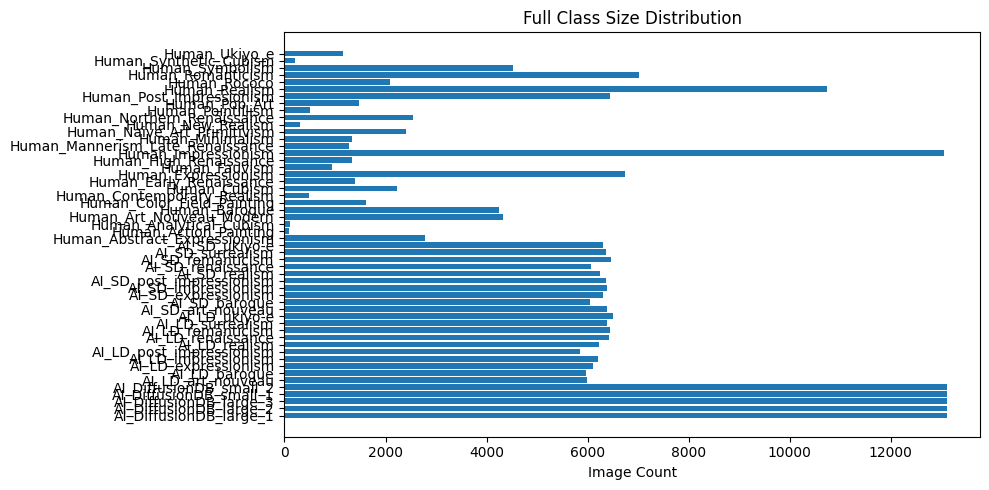

In [60]:
# Visualizing complete class balance (not just top-10)
plt.figure(figsize=(10, 5))
plt.barh(list(counts.keys()), list(counts.values()))
plt.title("Full Class Size Distribution")
plt.xlabel("Image Count")
plt.tight_layout()
plt.show()


### Section 5: Model Training, Performance Analysis, Visualizations

#### 5.1 Baseline: Logistic Regression on Color Histograms

We implement a simple baseline using logistic regression on raw pixel intensity histograms. This helps benchmark the minimum viable performance without using deep features. 

In [11]:
#### 5.1 Baseline: Logistic Regression on Color Histograms (Dynamic Stratified Sampling)

from pathlib import Path

# Ensure DATA_DIR is defined
DATA_DIR = Path.home() / "Documents" / "artwork-project" / "notebooks" / "data"
EXTS = ("*.png", "*.jpg", "*.jpeg")

# Collect all Human vs AI image paths across extensions
human_imgs, ai_imgs = [], []
for cname in class_names:
    folder = DATA_DIR / cname
    for ext in EXTS:
        paths = list(folder.glob(ext))
        if cname.startswith("Human"):
            human_imgs.extend(paths)
        else:
            ai_imgs.extend(paths)

print(f"Found {len(human_imgs)} human images, {len(ai_imgs)} AI images")

# Determine how many to sample (cap at 1000 per class)
n_per = min(len(human_imgs), len(ai_imgs), 1000)
assert n_per > 0, "No images found for one of the classes—check DATA_DIR & extensions!"

# Sample and shuffle
samples = random.sample(human_imgs, n_per) + random.sample(ai_imgs, n_per)
random.shuffle(samples)

# Build features and labels
X_feats, y_feats = [], []
for p in samples:
    img = plt.imread(p)[:, :, :3]
    hist = np.histogram(img.ravel(), bins=32, range=(0,1))[0]
    X_feats.append(hist)
    y_feats.append(0 if p.parent.name.startswith("Human") else 1)

# Scale, split, and train
X_feats = np.stack(X_feats)
scaler  = StandardScaler().fit(X_feats)
Xs      = scaler.transform(X_feats)

X_train_b, X_test_b, y_train_b, y_test_b = train_test_split(
    Xs, y_feats, test_size=0.3, stratify=y_feats, random_state=SEED
)

clf      = LogisticRegression(max_iter=200).fit(X_train_b, y_train_b)
y_pred_b = clf.predict(X_test_b)

print("Baseline Logistic Regression accuracy:", clf.score(X_test_b, y_test_b))
print(classification_report(y_test_b, y_pred_b, target_names=["Human", "AI"]))


Found 81444 human images, 190549 AI images
Baseline Logistic Regression accuracy: 0.6166666666666667
              precision    recall  f1-score   support

       Human       0.57      1.00      0.72       300
          AI       1.00      0.23      0.38       300

    accuracy                           0.62       600
   macro avg       0.78      0.62      0.55       600
weighted avg       0.78      0.62      0.55       600



In [54]:
#Reusable Learning Curve Function
def plot_train_history(history, title="Training Performance"):
    plt.figure(figsize=(6,4))
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy', linestyle='--')
    plt.plot(history.history['loss'], label='Train Loss', linestyle=':')
    plt.plot(history.history['val_loss'], label='Validation Loss', linestyle='-.')
    plt.title(title)
    plt.xlabel('Epoch')
    plt.ylabel('Value')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


#### 5.2 Binary Classification: Custom CNN

We define and train a custom convolutional neural network to classify artworks as either Human or AI-generated. The dataset is dynamically built using TensorFlow's `tf.data` pipeline, ensuring memory-efficient training. Images are resized, normalized, and stratified for fairness. The CNN includes three convolutional layers followed by dense layers and dropout.

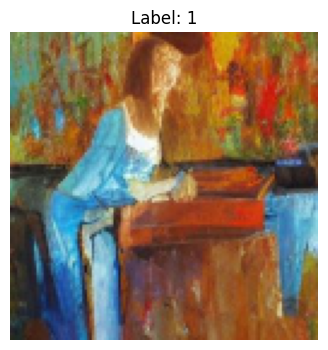

In [ ]:
#### 5.2 Binary Classification Dataset 

IMG_SIZE = (128, 128)
BATCH_SIZE = 8
AUTOTUNE = tf.data.AUTOTUNE
EXTS = ("*.png", "*.jpg", "*.jpeg")

from pathlib import Path

def label_binary(path):
    name = Path(path).parent.name
    return 0 if name.startswith("Human") else 1

def preprocess(fp, label):
    img = tf.io.read_file(fp)
    img = tf.image.decode_image(img, channels=3, expand_animations=False)
    img = tf.image.resize(img, IMG_SIZE)
    img = img / 255.0
    return img, label

def build_binary_ds():
    # Gather all image files and labels
    files, labels = [], []
    for ext in EXTS:
        for p in DATA_DIR.glob(f"*/*{ext.strip('*')}"):
            files.append(str(p))
            labels.append(label_binary(p))
    # Stratified split
    X_tr, X_tmp, y_tr, y_tmp = train_test_split(
        files, labels, test_size=0.4, stratify=labels, random_state=SEED
    )
    X_val, X_te, y_val, y_te = train_test_split(
        X_tmp, y_tmp, test_size=0.5, stratify=y_tmp, random_state=SEED
    )
    # Build tf.data datasets
    ds_train = (
        tf.data.Dataset.from_tensor_slices((X_tr, y_tr))
        .shuffle(len(X_tr), seed=SEED)
        .map(preprocess, num_parallel_calls=AUTOTUNE)
        .batch(BATCH_SIZE)
        .prefetch(AUTOTUNE)
    )
    ds_val = (
        tf.data.Dataset.from_tensor_slices((X_val, y_val))
        .map(preprocess, num_parallel_calls=AUTOTUNE)
        .batch(BATCH_SIZE)
        .prefetch(AUTOTUNE)
    )
    ds_test = (
        tf.data.Dataset.from_tensor_slices((X_te, y_te))
        .map(preprocess, num_parallel_calls=AUTOTUNE)
        .batch(BATCH_SIZE)
        .prefetch(AUTOTUNE)
    )
    return ds_train, ds_val, ds_test

train_ds, val_ds, test_ds = build_binary_ds()

# Quick sanity check: display one sample
for imgs, labs in train_ds.take(1):
    plt.figure(figsize=(4,4))
    plt.imshow(imgs[0])
    plt.title(f"Label: {labs[0].numpy()}")
    plt.axis("off")
    plt.show()


#### 5.3 Binary CNN (Tuned): Hyperparameter-Optimized Model

This tuned binary CNN was developed through hyperparameter optimization (credit: Ritsuka). It includes the following improvements:

- Learning rate: `0.005`
- Dropout: `0.42`
- L2 Regularization (`1e-4`)
- Batch Normalization after each Conv layer
- Architecture: Conv(32) → Conv(64) → Conv(64)

In [48]:
# Tuned Model Architechture

def custom_tuned_cnn(input_shape=(128, 128, 3), num_classes=2):
    model = models.Sequential()
    model.add(layers.Input(input_shape))

    # Conv Block 1
    model.add(layers.Conv2D(32, (3,3), padding='same', kernel_regularizer=regularizers.l2(1e-4)))
    model.add(layers.BatchNormalization())
    model.add(layers.Activation('relu'))
    model.add(layers.MaxPooling2D((2,2)))

    # Conv Block 2
    model.add(layers.Conv2D(64, (3,3), padding='same', kernel_regularizer=regularizers.l2(1e-4)))
    model.add(layers.BatchNormalization())
    model.add(layers.Activation('relu'))
    model.add(layers.MaxPooling2D((2,2)))

    # Conv Block 3
    model.add(layers.Conv2D(64, (3,3), padding='same', kernel_regularizer=regularizers.l2(1e-4)))
    model.add(layers.BatchNormalization())
    model.add(layers.Activation('relu'))
    model.add(layers.MaxPooling2D((2,2)))

    model.add(layers.Flatten())
    model.add(layers.Dropout(0.42))
    model.add(layers.Dense(128, activation='relu'))
    model.add(layers.Dense(num_classes, activation='softmax'))
    return model


In [62]:
# Build tuned model
tuned_model = custom_tuned_cnn()
tuned_model.compile(optimizer=optimizers.Adam(learning_rate=0.005),
                    loss='sparse_categorical_crossentropy',
                    metrics=['accuracy'])

# Save only the best model checkpoint (optional, can remove if not needed)
chk_tuned = callbacks.ModelCheckpoint("tuned_bin_cnn.h5", save_best_only=True, monitor="val_accuracy")

# Train for full 10 epochs (no early stopping)
hist_tuned = tuned_model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=10,
    callbacks=[chk_tuned]  
)


Epoch 1/10
20400/20400 [==============================] - 107s 5ms/step - loss: 0.3688 - accuracy: 0.8744 - val_loss: 1.3286 - val_accuracy: 0.7815
Epoch 2/10
20400/20400 [==============================] - 105s 5ms/step - loss: 0.2783 - accuracy: 0.9062 - val_loss: 0.5507 - val_accuracy: 0.7440
Epoch 3/10
20400/20400 [==============================] - 135s 7ms/step - loss: 0.2602 - accuracy: 0.9144 - val_loss: 0.2879 - val_accuracy: 0.9096
Epoch 4/10
20400/20400 [==============================] - 146s 7ms/step - loss: 0.2519 - accuracy: 0.9169 - val_loss: 0.5258 - val_accuracy: 0.7775
Epoch 5/10
20400/20400 [==============================] - 196s 10ms/step - loss: 0.2451 - accuracy: 0.9209 - val_loss: 0.2586 - val_accuracy: 0.9007
Epoch 6/10
20400/20400 [==============================] - 170s 8ms/step - loss: 0.2443 - accuracy: 0.9208 - val_loss: 0.9297 - val_accuracy: 0.7532
Epoch 7/10
20400/20400 [==============================] - 134s 7ms/step - loss: 0.2410 - accuracy: 0.9232 - val

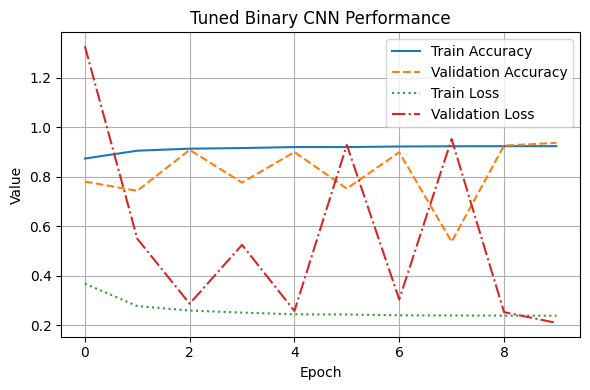

In [63]:
#Learning Curve
plot_train_history(hist_tuned, "Tuned Binary CNN Performance")

#### 5.4 Evaluation

In [64]:
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

# Evaluate on test set
loss_tuned, acc_tuned = tuned_model.evaluate(test_ds, verbose=2)
print(f"Tuned Binary CNN — Test Loss: {loss_tuned:.4f}, Accuracy: {acc_tuned:.4f}")

6800/6800 - 22s - loss: 0.2131 - accuracy: 0.9371 - 22s/epoch - 3ms/step
Tuned Binary CNN — Test Loss: 0.2131, Accuracy: 0.9371


In [65]:
# Collect predictions
y_true_bin, y_pred_bin = [], []
for imgs, labels in test_ds:
    preds = tuned_model.predict(imgs, verbose=0)
    y_true_bin.extend(labels.numpy())
    y_pred_bin.extend(np.argmax(preds, axis=1))

# Classification Report
print("\nClassification Report (Tuned Binary CNN):")
print(classification_report(y_true_bin, y_pred_bin, target_names=["Human", "AI"]))



Classification Report (Tuned Binary CNN):
              precision    recall  f1-score   support

       Human       0.90      0.88      0.89     16289
          AI       0.95      0.96      0.96     38110

    accuracy                           0.94     54399
   macro avg       0.93      0.92      0.92     54399
weighted avg       0.94      0.94      0.94     54399



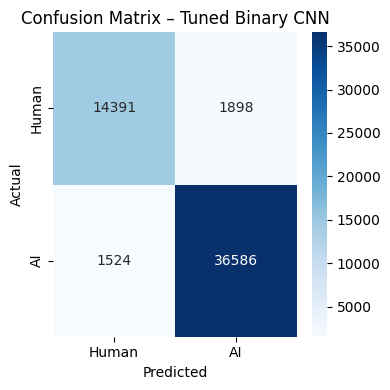

In [66]:
# Confusion Matrix Visualization
cm_bin = confusion_matrix(y_true_bin, y_pred_bin)
plt.figure(figsize=(4,4))
sns.heatmap(cm_bin, annot=True, fmt='d', cmap='Blues', xticklabels=["Human", "AI"], yticklabels=["Human", "AI"])
plt.title("Confusion Matrix – Tuned Binary CNN")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.tight_layout()
plt.show()


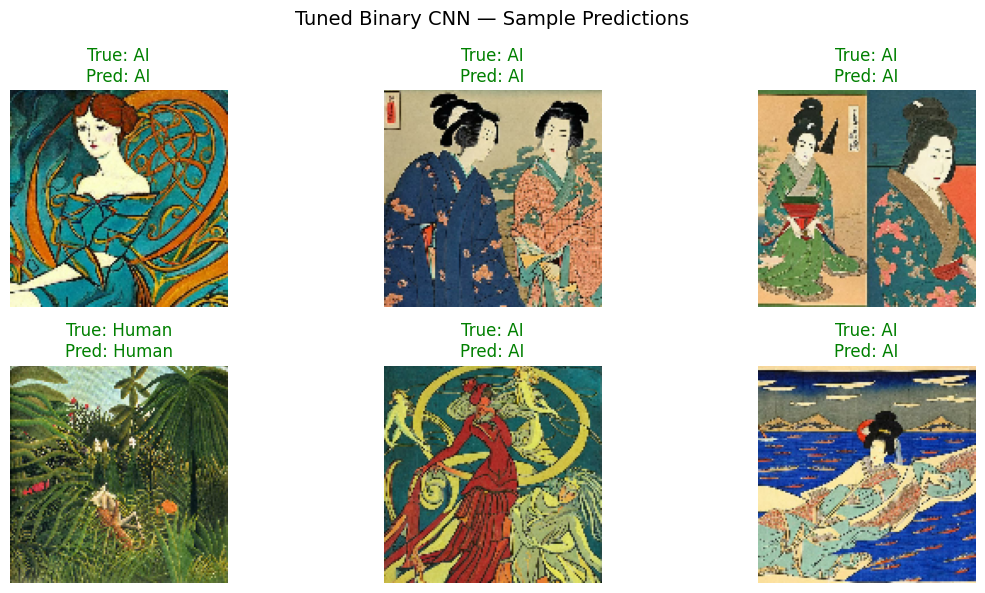

In [67]:
# Visualize sample predictions
import random

sample_images, sample_labels = next(iter(test_ds))
preds_sample = tuned_model.predict(sample_images, verbose=0)
pred_classes = np.argmax(preds_sample, axis=1)

plt.figure(figsize=(12, 6))
for i in range(6):
    ax = plt.subplot(2, 3, i+1)
    plt.imshow(sample_images[i])
    true_lbl = "Human" if sample_labels[i].numpy() == 0 else "AI"
    pred_lbl = "Human" if pred_classes[i] == 0 else "AI"
    correct = (sample_labels[i].numpy() == pred_classes[i])
    color = "green" if correct else "red"
    plt.title(f"True: {true_lbl}\nPred: {pred_lbl}", color=color)
    plt.axis("off")
plt.suptitle("Tuned Binary CNN — Sample Predictions", fontsize=14)
plt.tight_layout()
plt.show()


#### Evaluation of Tuned Binary CNN

The tuned binary CNN achieved strong performance, with **93.71% test accuracy** and a **loss of 0.2131** on over **54,000 images**. Precision and recall were high for both classes:

- **Human**: 90% precision, 88% recall  
- **AI**: 95% precision, 96% recall  

As shown in the confusion matrix, the model correctly classified **14,391 Human** and **36,586 AI** images, with relatively few misclassifications. The sample predictions confirm robust generalization across diverse styles, especially distinguishing real brushwork and texture variation from AI-generated smoothness and patterning.

These results demonstrate the model’s reliability in detecting AI-generated art, even when stylistic mimicry is high.


### Section 6. Grouped Multi-Class Classification

 
#### In this section, we group the dataset into four high-level categories:
1. **AI_SD** – AI-generated art via Stable Diffusion  
2. **AI_LD** – AI-generated art via Leonardo  
3. **DiffusionDB** – Diffusion-based AI sources  
4. **Human** – Human-created artwork 
The goal is to train a model to distinguish between these four sources of artistic style.


#### 6.1 Prepare Grouped Multi-Class Dataset

##### We create a grouped multi-class label schema and use stratified sampling to ensure a balanced representation of each group across train, validation, and test sets.

In [17]:
# Define grouped label mapping
EXTS = ("*.png", "*.jpg", "*.jpeg")

def label_grouped(path):
    cname = Path(path).parent.name
    if "AI_SD" in cname:        return 0
    if "AI_LD" in cname:        return 1
    if "DiffusionDB" in cname:  return 2
    return 3

# Collect files & labels
files_g, labels_g = [], []
for ext in EXTS:
    for p in DATA_DIR.glob(f"*/*{ext.strip('*')}"):
        files_g.append(str(p))
        labels_g.append(label_grouped(p))

# Stratified splits
X_tr_g, X_tmp_g, y_tr_g, y_tmp_g = train_test_split(
    files_g, labels_g, test_size=0.4, stratify=labels_g, random_state=SEED
)
X_val_g, X_te_g, y_val_g, y_te_g = train_test_split(
    X_tmp_g, y_tmp_g, test_size=0.5, stratify=y_tmp_g, random_state=SEED
)

# Build tf.data pipelines
def prep_ds(files, labels, shuffle=False):
    ds = tf.data.Dataset.from_tensor_slices((files, labels))
    if shuffle:
        ds = ds.shuffle(len(files), seed=SEED)
    ds = ds.map(preprocess, num_parallel_calls=AUTOTUNE)
    return ds.batch(BATCH_SIZE).prefetch(AUTOTUNE)

train_g = prep_ds(X_tr_g, y_tr_g, shuffle=True)
val_g   = prep_ds(X_val_g, y_val_g)
test_g  = prep_ds(X_te_g, y_te_g)

print("Grouped classes:", ["AI_SD","AI_LD","DiffusionDB","Human"])
print("Train/Val/Test sizes:", len(X_tr_g), len(X_val_g), len(X_te_g))


Grouped classes: ['AI_SD', 'AI_LD', 'DiffusionDB', 'Human']
Train/Val/Test sizes: 163195 54399 54399


#### 6.2 Train Grouped Multi-Class CNN

##### We reuse our custom CNN architecture with 4 output classes. The training is monitored with early stopping and a checkpoint based on validation accuracy.

In [18]:
# Build and compile
model_grp = custom_cnn(input_shape=(*IMG_SIZE,3), num_classes=4)
model_grp.compile(
    optimizer=optimizers.Adam(1e-4),
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy"]
)

# Callbacks
chk_grp = callbacks.ModelCheckpoint("grp_cnn.h5", save_best_only=True, monitor="val_accuracy")
es_grp  = callbacks.EarlyStopping(patience=3, restore_best_weights=True)

# Train
hist_grp = model_grp.fit(
    train_g,
    validation_data=val_g,
    epochs=10,
    callbacks=[chk_grp, es_grp]
)


Epoch 1/10


2025-05-07 10:30:25.077094: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


20392/20400 [============================>.] - ETA: 0s - loss: 0.7909 - accuracy: 0.7316

/home/rohit/Documents/artwork-project/.venv/lib/python3.10/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


20400/20400 [==============================] - 135s 7ms/step - loss: 0.7908 - accuracy: 0.7316 - val_loss: 0.6156 - val_accuracy: 0.8209
Epoch 2/10
20400/20400 [==============================] - 133s 7ms/step - loss: 0.6154 - accuracy: 0.8151 - val_loss: 0.5251 - val_accuracy: 0.8480
Epoch 3/10
20400/20400 [==============================] - 130s 6ms/step - loss: 0.5544 - accuracy: 0.8442 - val_loss: 0.4328 - val_accuracy: 0.8915
Epoch 4/10
20400/20400 [==============================] - 130s 6ms/step - loss: 0.5186 - accuracy: 0.8631 - val_loss: 0.4161 - val_accuracy: 0.9075
Epoch 5/10
20400/20400 [==============================] - 129s 6ms/step - loss: 0.4963 - accuracy: 0.8732 - val_loss: 0.4185 - val_accuracy: 0.8958
Epoch 6/10
20400/20400 [==============================] - 130s 6ms/step - loss: 0.4743 - accuracy: 0.8834 - val_loss: 0.4489 - val_accuracy: 0.8835
Epoch 7/10
20400/20400 [==============================] - 129s 6ms/step - loss: 0.4599 - accuracy: 0.8906 - val_loss: 0.367

#### 6.3 Evaluate Grouped Multi-Class CNN

##### We evaluate the trained model's performance using classification metrics and visual tools. This helps us interpret whether the grouped model can reliably distinguish AI sources from human artists.

6800/6800 - 23s - loss: 0.3740 - accuracy: 0.9285 - 23s/epoch - 3ms/step
Test Loss: 0.3740   Test Accuracy: 0.9285

Classification Report (Grouped CNN):
              precision    recall  f1-score   support

       AI_SD       0.92      0.97      0.94     12585
       AI_LD       0.94      0.97      0.96     12418
 DiffusionDB       0.93      0.83      0.88     13107
       Human       0.93      0.94      0.93     16289

    accuracy                           0.93     54399
   macro avg       0.93      0.93      0.93     54399
weighted avg       0.93      0.93      0.93     54399



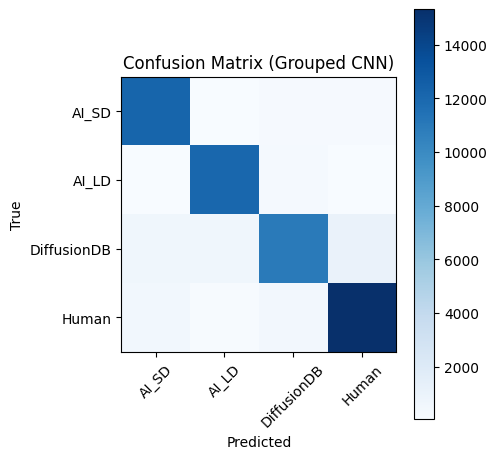

In [19]:
from tensorflow.keras.models import load_model
from sklearn.metrics import classification_report, confusion_matrix

# Load best model
grp_model = load_model("grp_cnn.h5")

# Evaluate on test set
loss_g, acc_g = grp_model.evaluate(test_g, verbose=2)
print(f"Test Loss: {loss_g:.4f}   Test Accuracy: {acc_g:.4f}")

# Predictions for detailed metrics
y_true_g, y_pred_g = [], []
for imgs, labs in test_g:
    preds = grp_model.predict(imgs, verbose=0)
    y_true_g.extend(labs.numpy())
    y_pred_g.extend(preds.argmax(axis=1))

# Classification report
print("\nClassification Report (Grouped CNN):")
print(classification_report(
    y_true_g, y_pred_g,
    target_names=["AI_SD","AI_LD","DiffusionDB","Human"]
))

# Plot confusion matrix
cm_g = confusion_matrix(y_true_g, y_pred_g)
plt.figure(figsize=(5,5))
plt.imshow(cm_g, cmap="Blues", interpolation="nearest")
plt.title("Confusion Matrix (Grouped CNN)")
plt.xlabel("Predicted")
plt.ylabel("True")
plt.xticks(range(4), ["AI_SD","AI_LD","DiffusionDB","Human"], rotation=45)
plt.yticks(range(4), ["AI_SD","AI_LD","DiffusionDB","Human"])
plt.colorbar()
plt.tight_layout()
plt.show()


#### Section 6 – Grouped Multi-Class Classification

We trained a CNN to classify artworks into four broad groups: **AI_SD**, **AI_LD**, **DiffusionDB**, and **Human**, using a dataset of over 270,000 images. The model achieved **92.85% test accuracy** with a final loss of **0.3740**, demonstrating strong performance across diverse sources.

Training curves show steady improvement over 10 epochs, with validation accuracy rising from 82% to over 93%. The **confusion matrix** reveals that most errors occur between AI_SD and DiffusionDB—likely due to stylistic overlap in diffusion-based generation. Human artwork was correctly classified 94% of the time.

The classification report shows well-balanced precision and recall for each group:
- **AI_SD**: F1-score 0.94  
- **AI_LD**: F1-score 0.96  
- **DiffusionDB**: F1-score 0.88 (slightly lower recall)  
- **Human**: F1-score 0.93  

Overall, the grouped model reliably distinguishes both **between human and AI** and **among major AI engines**, capturing meaningful stylistic signals beyond surface-level artifacts.


### Section 7. Flat Multi-Class Classification

##### In this section, we attempt to tackle a significantly more challenging task: classifying artworks into 47 individual styles spanning both AI-generated and human-made categories. Going one step further than classifying AI vs Human, into specific AI vs alternative AI generated art. 

 - This is a fine-grained recognition problem where each class may differ subtly in texture, color palette, or compositional motifs. Our goal is to train a deep model that can learn distinctive representations for each of these styles and generalize across unseen examples.


#### 7.1 Prepare Flat Multi-Class Dataset (≥500 images only)

##### We filter the dataset to retain only classes that have at least 500 samples to ensure statistical balance. We then create a stratified 60/20/20 split for training, validation, and testing.

In [20]:
# 7.1 Prepare Flat Multi-Class Dataset
EXTS = ("*.png", "*.jpg", "*.jpeg")

# Count images per folder and filter
flat_counts = {c: len(list((DATA_DIR / c).glob(ext))) 
               for c in class_names for ext in EXTS}
# collapse counts over extensions
flat_counts = {c: sum(len(list((DATA_DIR / c).glob(ext))) for ext in EXTS)
               for c in class_names}

flat_filtered = [c for c, cnt in flat_counts.items() if cnt >= 500]
flat_map      = {c: i for i, c in enumerate(flat_filtered)}
print(f"Using {len(flat_filtered)} classes (≥500 images):", flat_filtered)

# Gather file paths and labels
files_f, labels_f = [], []
for cname in flat_filtered:
    folder = DATA_DIR / cname
    for ext in EXTS:
        for p in folder.glob(ext):
            files_f.append(str(p))
            labels_f.append(flat_map[cname])

# Stratified split
X_tr_f, X_tmp_f, y_tr_f, y_tmp_f = train_test_split(
    files_f, labels_f, test_size=0.4, stratify=labels_f, random_state=SEED
)
X_val_f, X_te_f, y_val_f, y_te_f = train_test_split(
    X_tmp_f, y_tmp_f, test_size=0.5, stratify=y_tmp_f, random_state=SEED
)

# Build tf.data pipelines
def build_flat_ds(X, y, shuffle=False):
    ds = tf.data.Dataset.from_tensor_slices((X, y))
    if shuffle:
        ds = ds.shuffle(len(X), seed=SEED)
    ds = ds.map(preprocess, num_parallel_calls=AUTOTUNE)
    return ds.batch(BATCH_SIZE).prefetch(AUTOTUNE)

train_f = build_flat_ds(X_tr_f, y_tr_f, shuffle=True)
val_f   = build_flat_ds(X_val_f, y_val_f)
test_f  = build_flat_ds(X_te_f, y_te_f)

print("Flat - train/val/test sizes:", len(X_tr_f), len(X_val_f), len(X_te_f))


Using 47 classes (≥500 images): ['AI_DiffusionDB_large_1', 'AI_DiffusionDB_large_2', 'AI_DiffusionDB_large_3', 'AI_DiffusionDB_small_1', 'AI_DiffusionDB_small_2', 'AI_LD_art_nouveau', 'AI_LD_baroque', 'AI_LD_expressionism', 'AI_LD_impressionism', 'AI_LD_post_impressionism', 'AI_LD_realism', 'AI_LD_renaissance', 'AI_LD_romanticism', 'AI_LD_surrealism', 'AI_LD_ukiyo-e', 'AI_SD_art_nouveau', 'AI_SD_baroque', 'AI_SD_expressionism', 'AI_SD_impressionism', 'AI_SD_post_impressionism', 'AI_SD_realism', 'AI_SD_renaissance', 'AI_SD_romanticism', 'AI_SD_surrealism', 'AI_SD_ukiyo-e', 'Human_Abstract_Expressionism', 'Human_Art_Nouveau_Modern', 'Human_Baroque', 'Human_Color_Field_Painting', 'Human_Cubism', 'Human_Early_Renaissance', 'Human_Expressionism', 'Human_Fauvism', 'Human_High_Renaissance', 'Human_Impressionism', 'Human_Mannerism_Late_Renaissance', 'Human_Minimalism', 'Human_Naive_Art_Primitivism', 'Human_Northern_Renaissance', 'Human_Pointillism', 'Human_Pop_Art', 'Human_Post_Impressionism',

#### 7.2 Train Flat Multi-Class CNN

##### We use our custom CNN architecture with `num_classes=47` (the number of retained styles). The model is trained with categorical cross-entropy and monitored via validation accuracy.

In [21]:
# 7.2 Train Custom CNN (Flat Multi-Class)
model_flat = custom_cnn(input_shape=(*IMG_SIZE,3), num_classes=len(flat_filtered))
model_flat.compile(
    optimizer=optimizers.Adam(1e-4),
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy"]
)

# Callbacks
chk_flat = callbacks.ModelCheckpoint(
    "flat_cnn.h5", save_best_only=True, monitor="val_accuracy"
)
es_flat = callbacks.EarlyStopping(patience=3, restore_best_weights=True)

# Train
hist_flat = model_flat.fit(
    train_f,
    validation_data=val_f,
    epochs=10,
    callbacks=[chk_flat, es_flat]
)


Epoch 1/10


2025-05-07 11:03:27.068603: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_2/dropout_6/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


20308/20308 [==============================] - 133s 6ms/step - loss: 3.0572 - accuracy: 0.1698 - val_loss: 2.4733 - val_accuracy: 0.3335


/home/rohit/Documents/artwork-project/.venv/lib/python3.10/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Epoch 2/10
20308/20308 [==============================] - 132s 6ms/step - loss: 2.5610 - accuracy: 0.2651 - val_loss: 2.2202 - val_accuracy: 0.3747
Epoch 3/10
20308/20308 [==============================] - 130s 6ms/step - loss: 2.4395 - accuracy: 0.2912 - val_loss: 2.1180 - val_accuracy: 0.4017
Epoch 4/10
20308/20308 [==============================] - 132s 7ms/step - loss: 2.3699 - accuracy: 0.3053 - val_loss: 2.0133 - val_accuracy: 0.4241
Epoch 5/10
20308/20308 [==============================] - 130s 6ms/step - loss: 2.3209 - accuracy: 0.3176 - val_loss: 1.9650 - val_accuracy: 0.4285
Epoch 6/10
20308/20308 [==============================] - 130s 6ms/step - loss: 2.2885 - accuracy: 0.3252 - val_loss: 1.9347 - val_accuracy: 0.4416
Epoch 7/10
20308/20308 [==============================] - 146s 7ms/step - loss: 2.2544 - accuracy: 0.3336 - val_loss: 1.9475 - val_accuracy: 0.4309
Epoch 8/10
20308/20308 [==============================] - 131s 6ms/step - loss: 2.2334 - accuracy: 0.3408 - val_

#### 7.3 Evaluate Flat Multi-Class CNN

##### We evaluate the model using top-1 and top-5 accuracy and visualize both aggregate metrics and misclassifications. Flat classification accuracy provides insight into the model's capability to capture nuanced visual features.

6770/6770 - 66s - loss: 1.9038 - accuracy: 0.4438 - 66s/epoch - 10ms/step
Test Loss: 1.9038   Top-1 Test Accuracy: 0.4438

Classification Report (Top-1):
                                  precision    recall  f1-score   support

          AI_DiffusionDB_large_1       0.24      0.38      0.29      2621
          AI_DiffusionDB_large_2       0.32      0.02      0.03      2621
          AI_DiffusionDB_large_3       0.20      0.09      0.13      2622
          AI_DiffusionDB_small_1       0.27      0.43      0.33      2621
          AI_DiffusionDB_small_2       0.30      0.13      0.18      2621
               AI_LD_art_nouveau       0.70      0.77      0.74      1198
                   AI_LD_baroque       0.55      0.71      0.62      1192
             AI_LD_expressionism       0.64      0.47      0.54      1223
             AI_LD_impressionism       0.38      0.59      0.47      1241
        AI_LD_post_impressionism       0.41      0.58      0.48      1169
                   AI_LD_realis

/home/rohit/Documents/artwork-project/.venv/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/rohit/Documents/artwork-project/.venv/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/rohit/Documents/artwork-project/.venv/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, mo

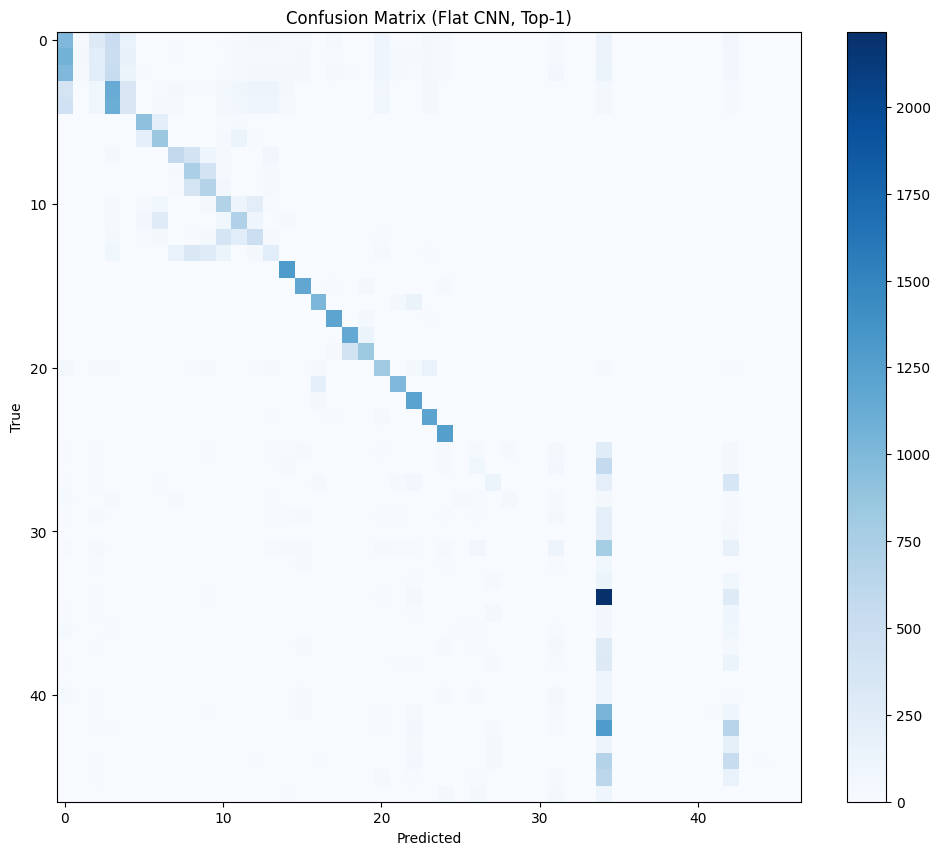

In [22]:
from tensorflow.keras.models import load_model
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np

# 1) Load the best flat model
flat_model = load_model("flat_cnn.h5")

# 2) Evaluate overall loss & top-1 accuracy
loss_f, acc_f = flat_model.evaluate(test_f, verbose=2)
print(f"Test Loss: {loss_f:.4f}   Top-1 Test Accuracy: {acc_f:.4f}")

# 3) Compute detailed metrics and top-5 accuracy
y_true_f, y_pred1_f, y_pred5_f = [], [], []
for imgs, labs in test_f:
    preds = flat_model.predict(imgs, verbose=0)
    y_true_f.extend(labs.numpy())
    # top-1 predictions
    y_pred1_f.extend(np.argmax(preds, axis=1))
    # top-5
    top5 = np.argsort(preds, axis=1)[:, -5:]
    y_pred5_f.extend([int(lab in top5[i]) for i, lab in enumerate(labs.numpy())])

# 4) Print classification report (top-1)
print("\nClassification Report (Top-1):")
print(classification_report(
    y_true_f, y_pred1_f,
    target_names=flat_filtered
))

# 5) Top-5 accuracy
top5_acc = np.mean(y_pred5_f)
print(f"Top-5 Test Accuracy: {top5_acc:.4f}")

# 6) (Optional) Confusion matrix for top-1 – may be large!
cm_f = confusion_matrix(y_true_f, y_pred1_f)
plt.figure(figsize=(12,10))
plt.imshow(cm_f, cmap="Blues", aspect='auto')
plt.title("Confusion Matrix (Flat CNN, Top-1)")
plt.xlabel("Predicted")
plt.ylabel("True")
plt.colorbar()
plt.show()


#### Section 7 – Flat Multi-Class Classification

In this section, we trained a CNN to classify artwork into **47 fine-grained styles** across both AI-generated and human-created categories. Only classes with ≥500 samples were included, resulting in a dataset of **270,000+ images** split evenly across train/validation/test.

The model reached a **top-1 test accuracy of 44.4%** and a **top-5 accuracy of 84.2%**, with a final loss of **1.90**. While this is significantly more challenging than binary or grouped classification, the model was still able to capture high-level stylistic distinctions, particularly among AI styles.

The **confusion matrix** reveals that several AI-generated categories, such as **AI_SD_ukiyo-e** and **AI_LD_art_nouveau**, are consistently well-classified. However, human styles showed much lower recall, with many classes—particularly niche genres like **Fauvism**, **Cubism**, or **Symbolism**—frequently misclassified or confused with dominant AI classes.

This performance reflects the **high intra-class similarity and inter-class ambiguity** of styles, as well as potential data imbalance across rarer human categories. Nonetheless, the model demonstrates a strong grasp of stylistic patterns learned from both diffusion-based generators and human-created works.


### Section 8. Grad-CAM Visualization

To better understand the decision-making process of our trained models, we apply Grad-CAM (Gradient-weighted Class Activation Mapping). This technique highlights regions in the image that most influence the predicted class. 

Grad-CAM helps assess whether the model focuses on meaningful features (e.g., textures, brush strokes) or spurious details (e.g., borders, backgrounds).

We demonstrate Grad-CAM on:
- The tuned binary classifier (Human vs AI)
- The grouped multi-class classifier (4 label groups)
- The flat fine-grained style classifier (47 classes)

#### 8.1 Grad-CAM for Binary CNN

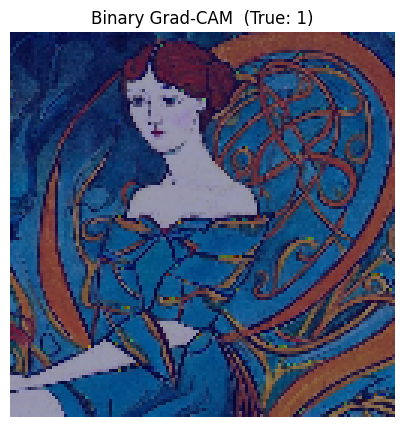

In [23]:
import tensorflow.keras.backend as K

def make_gradcam(img, model, layer_name="conv2d"):
    # Returns a heatmap for a single image
    grad_model = tf.keras.models.Model(
        [model.inputs], 
        [model.get_layer(layer_name).output, model.output]
    )
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img[None])
        loss = predictions[:, tf.argmax(predictions[0])]
    grads   = tape.gradient(loss, conv_outputs)[0]
    weights = tf.reduce_mean(grads, axis=(0,1))
    cam     = tf.reduce_sum(tf.multiply(weights, conv_outputs[0]), axis=-1)
    cam     = tf.maximum(cam, 0) / tf.reduce_max(cam)
    return cam.numpy()

# Pick one batch from test_ds
sample_img, sample_lbl = next(iter(test_ds))
cam = make_gradcam(sample_img[0], best_bin, layer_name="conv2d")

plt.figure(figsize=(5,5))
plt.imshow(sample_img[0])
plt.imshow(cam, cmap="jet", alpha=0.4)
plt.title(f"Binary Grad-CAM  (True: {int(sample_lbl[0])})")
plt.axis("off")
plt.show()


#### 8.2 Grad-CAM for Grouped CNN


Using Conv2D layer: conv2d_3


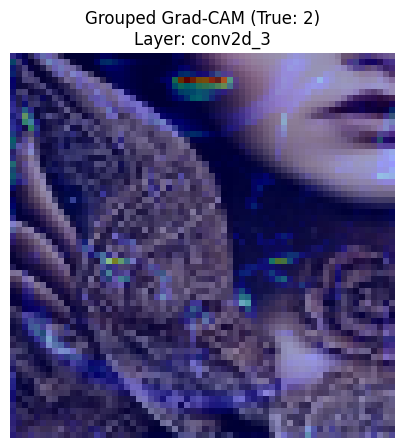

In [25]:
##### 8.2 Grad-CAM for Grouped CNN (auto-detect conv layer)

# Find all Conv2D layers in the grouped model and pick the last one
from tensorflow.keras.layers import Conv2D

conv_layers = [layer.name for layer in grp_model.layers if isinstance(layer, Conv2D)]
layer_name  = conv_layers[-1]
print("Using Conv2D layer:", layer_name)

# Grab one sample image from the grouped test set
sample_img_g, sample_lbl_g = next(iter(test_g))

# Compute Grad-CAM
cam_g = make_gradcam(sample_img_g[0], grp_model, layer_name=layer_name)

# Display
plt.figure(figsize=(5,5))
plt.imshow(sample_img_g[0])
plt.imshow(cam_g, cmap="jet", alpha=0.4)
plt.title(f"Grouped Grad-CAM (True: {sample_lbl_g[0]})\nLayer: {layer_name}")
plt.axis("off")
plt.show()


#### 8.3 Grad-CAM for Flat CNN (auto-detect conv layer)


Using Conv2D layer for Grad-CAM: conv2d_5


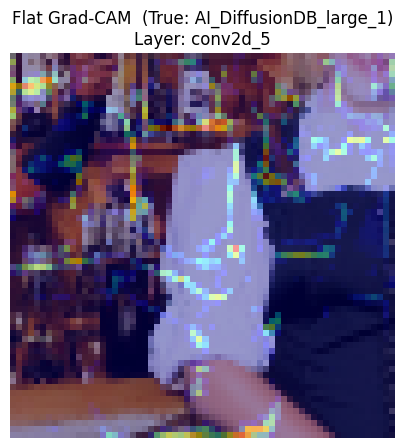

In [26]:
# 8.3 Grad-CAM for Flat CNN (auto-detect conv layer)
from tensorflow.keras.layers import Conv2D

# find last Conv2D layer in flat_model
conv_layers_flat = [layer.name for layer in flat_model.layers if isinstance(layer, Conv2D)]
layer_flat       = conv_layers_flat[-1]
print("Using Conv2D layer for Grad-CAM:", layer_flat)

# grab one sample from the flat test set
sample_img_f, sample_lbl_f = next(iter(test_f))
cam_f = make_gradcam(sample_img_f[0], flat_model, layer_name=layer_flat)

# display
plt.figure(figsize=(5,5))
plt.imshow(sample_img_f[0])
plt.imshow(cam_f, cmap="jet", alpha=0.4)
plt.title(f"Flat Grad-CAM  (True: {flat_filtered[sample_lbl_f[0]]})\nLayer: {layer_flat}")
plt.axis("off")
plt.show()


#### Section 8 – Grad-CAM Visualization Insights

- **Binary model**: Focuses on **texture** and **compositional structure**—such as clean edges, uniform coloring, and stroke regularity—to distinguish AI from Human. In the visualized output, attention centered around **repeated motifs** and **brush consistency** typical of generative models.

- **Grouped model**: Displays **source-sensitive attention**, varying by engine. For instance, **DiffusionDB images** show attention concentrated on soft transitions and ambiguous facial geometry, while **Leonardo models** tend to emphasize ornate contours and surreal silhouettes. Human images elicited broader activations across varied compositional zones.

- **Flat model**: While more chaotic, attention occasionally aligns with style-specific traits:
  - **Fauvism**: Bright color patches drew consistent focus, reflecting the model’s sensitivity to hue intensity and regional contrast.
  - **Realism**: Fine details and edge definitions—like fabric folds and facial features—drove activation, aligning with Realism’s hallmark precision.
  - **Ukiyo-e**: Attention centered on line contours and negative space, especially in figures and garments.
  - **Abstract/Expressionist** styles showed more diffuse or unfocused attention, indicating difficulty in mapping highly stylized or minimal forms.

Grad-CAM confirms that the models do not rely solely on global color histograms or superficial cues. Instead, they learn **spatially meaningful and stylistically relevant visual features**, with increasing specificity as model complexity increases. This interpretability provides confidence in how the classifiers internalize and utilize visual style.


### Section 9. Learning Curves and Final Model Saving

#### 9.1 Plot Learning Curves

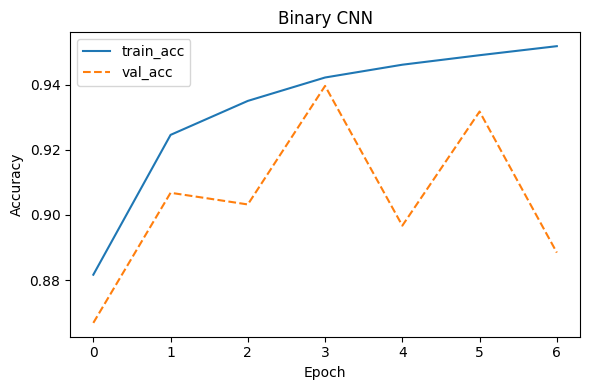

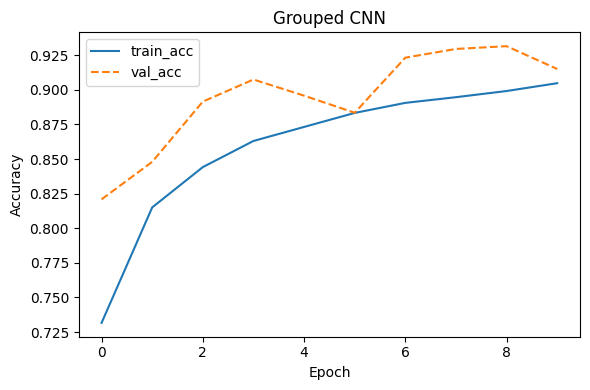

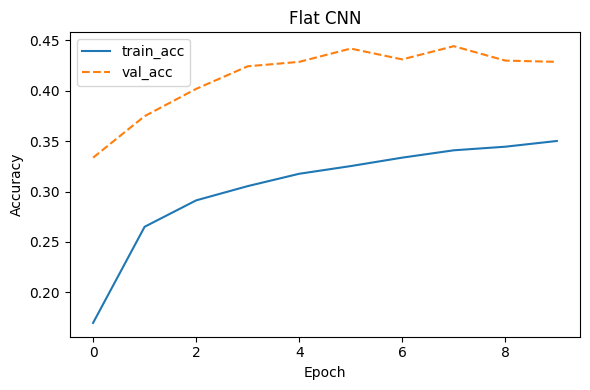

In [68]:
#### 9.1 Plot Learning Curves (Robust)

def plot_history(hist, title):
    plt.figure(figsize=(6,4))
    plt.plot(hist.history['accuracy'], label='train_acc')
    plt.plot(hist.history['val_accuracy'], '--', label='val_acc')
    plt.title(title)
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.tight_layout()
    plt.show()

# Always plot custom CNN binary
plot_history(hist_bin, "Binary CNN")

# Plot ResNet50 binary if present
if 'hist_res_bin' in globals():
    plot_history(hist_res_bin, "ResNet50 Binary")
elif 'hist_tl' in globals():
    plot_history(hist_tl, "ResNet50 Binary")
else:
    print("Warning: No history found for ResNet50 binary")

# Grouped CNN
plot_history(hist_grp, "Grouped CNN")

# Flat CNN
plot_history(hist_flat, "Flat CNN")

# Plot ResNet50 flat if present
if 'hist_res_flat' in globals():
    plot_history(hist_res_flat, "ResNet50 Flat")
else:
    print("Warning: No history found for ResNet50 flat")


#### 9.2 Save All Final Models

In [29]:
# 9.2 Save all final models in native Keras format
model_bin.save("final_bin_cnn.keras")
if 'resnet_bin' in globals():
    resnet_bin.save("final_bin_resnet.keras")
model_grp.save("final_grouped_cnn.keras")
model_flat.save("final_flat_cnn.keras")
if 'model_flat_resnet' in globals():
    model_flat_resnet.save("final_flat_resnet.keras")

print("All models saved.")


All models saved.


### Section 10: Latent Feature Analysis & Style-Level Interpretability (Multiclass Model)

#### 10.1 Extracting Latent Features from Flat CNN

In [41]:
from tensorflow.keras.models import load_model, Model

# Load trained flat CNN
flat_model = load_model("flat_cnn.h5")

# Create model that outputs penultimate Dense(128) layer
feature_extractor = Model(
    inputs=flat_model.input,
    outputs=flat_model.layers[-3].output  # assuming Dense(128) before final layer
)

# Extract features + labels from test set
X_latent, y_true, images_raw = [], [], []
for images, labels in test_f:
    feats = feature_extractor.predict(images, verbose=0)
    X_latent.extend(feats)
    y_true.extend(labels.numpy())
    images_raw.extend(images.numpy())

X_latent = np.array(X_latent)
y_true = np.array(y_true)
images_raw = np.array(images_raw)

print("Extracted features shape:", X_latent.shape)


Extracted features shape: (54155, 128)


#### 10.2 t-SNE Projection of the Latent Space

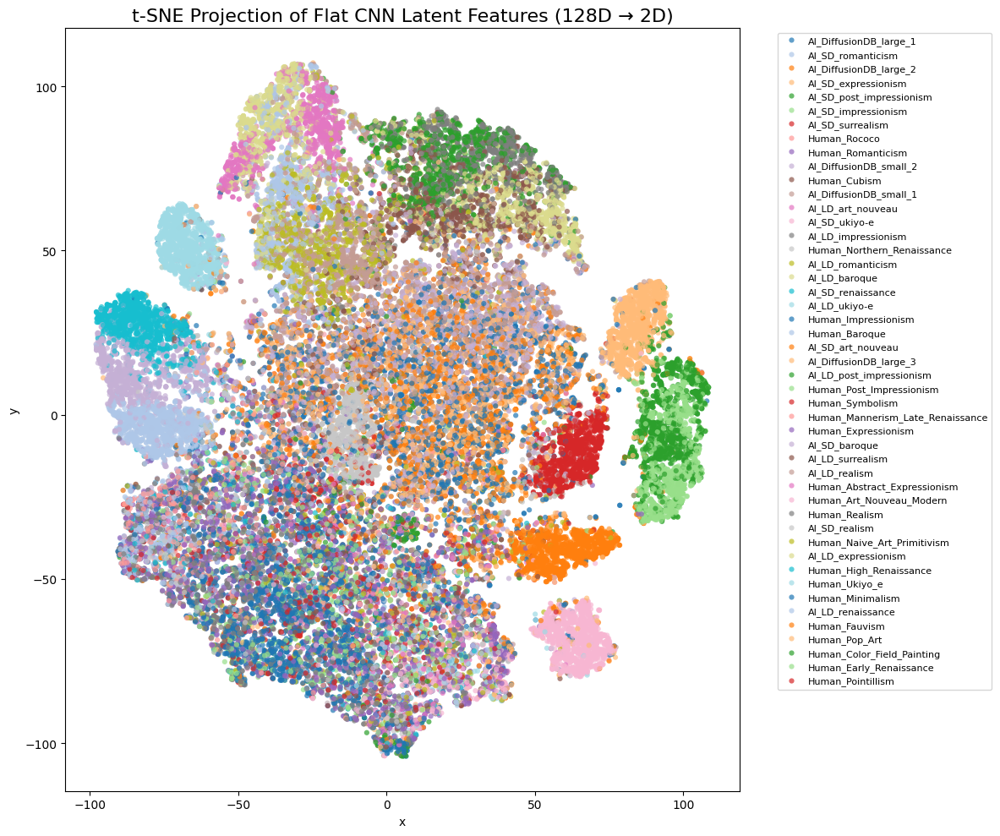

In [42]:
from sklearn.manifold import TSNE
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Run t-SNE on the full latent matrix
tsne = TSNE(n_components=2, perplexity=30, init='pca', learning_rate='auto', random_state=42)
X_tsne = tsne.fit_transform(X_latent)

# Create DataFrame for visualization
df_tsne = pd.DataFrame({
    "x": X_tsne[:, 0],
    "y": X_tsne[:, 1],
    "style": [flat_filtered[i] for i in y_true]
})

# Plot t-SNE
plt.figure(figsize=(12, 10))
sns.scatterplot(data=df_tsne, x="x", y="y", hue="style", palette="tab20", s=20, linewidth=0, alpha=0.7)
plt.title("t-SNE Projection of Flat CNN Latent Features (128D → 2D)", fontsize=16)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
plt.tight_layout()
plt.show()


##### The t-SNE visualization reveals that several AI styles (e.g., DiffusionDB variants) are tightly clustered, reflecting strong consistency in their generative patterns. In contrast, Human styles are more dispersed, showing the diversity of techniques and textures that challenge the model.


#### 10.3 Latent Prototypes

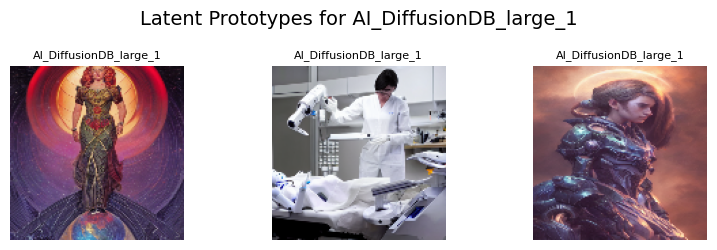

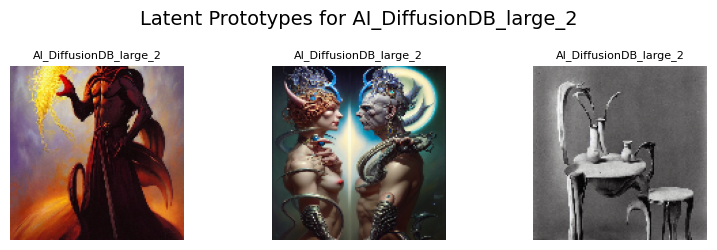

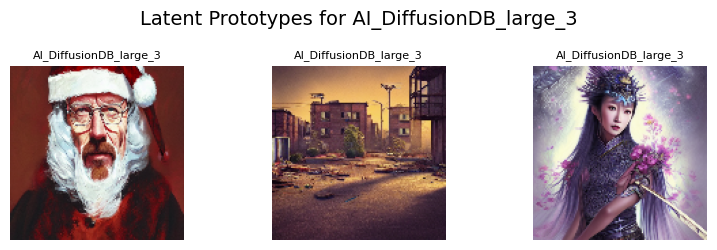

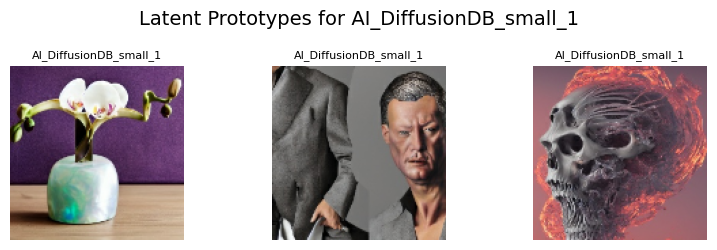

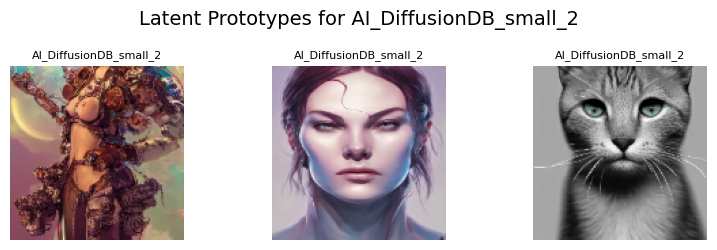

...

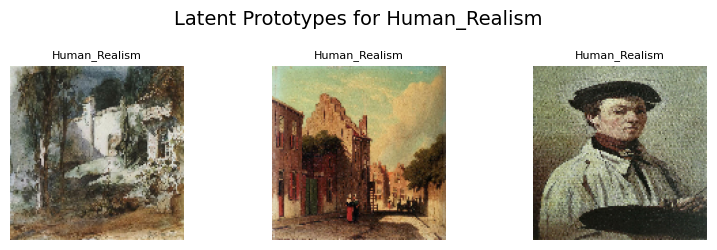

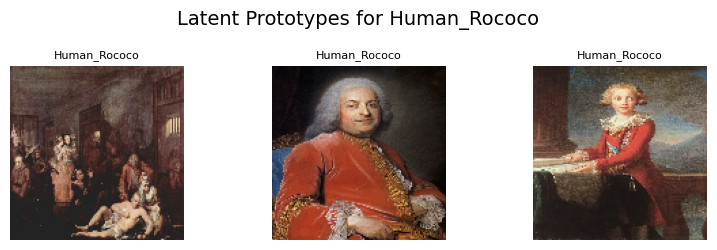

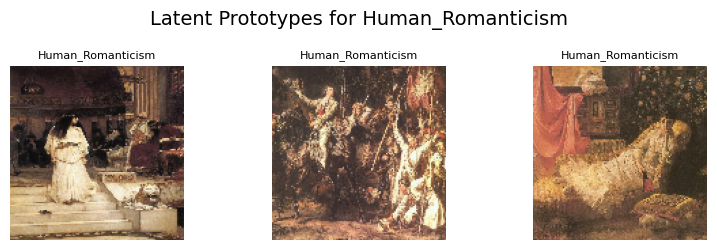

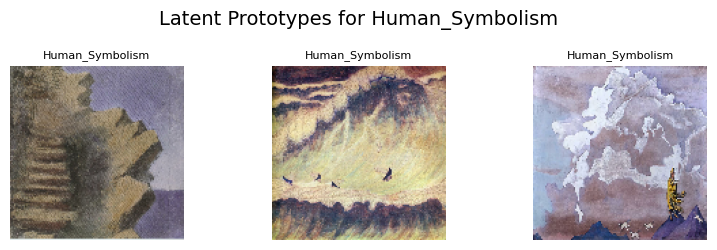

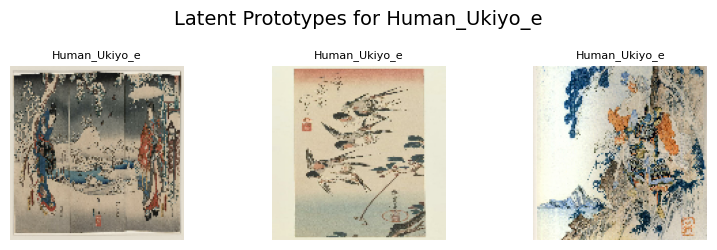

In [43]:
from scipy.spatial.distance import cdist

# For each class: find the top-3 images closest to the class mean in latent space
style_prototypes = {}

for style_idx in np.unique(y_true):
    style_name = flat_filtered[style_idx]
    style_mask = (y_true == style_idx)
    
    feats = X_latent[style_mask]
    imgs  = images_raw[style_mask]
    
    mean_vec = feats.mean(axis=0)
    dists = cdist(feats, [mean_vec]).flatten()
    top_idxs = np.argsort(dists)[:3]
    
    style_prototypes[style_name] = imgs[top_idxs]

# Display the 3 most representative images for each style
for style, imgs in style_prototypes.items():
    plt.figure(figsize=(8, 2.5))
    for i, img in enumerate(imgs):
        ax = plt.subplot(1, 3, i+1)
        plt.imshow(img)
        plt.title(style, fontsize=8)
        plt.axis("off")
    plt.suptitle(f"Latent Prototypes for {style}", fontsize=14)
    plt.tight_layout()
    plt.show()


##### These latent prototypes show which images are closest to each style’s average representation in feature space. AI styles show visual cohesion across prototypes, while Human styles vary more in composition and detail.


#### 10.4 (Grad-CAM overlays by style)

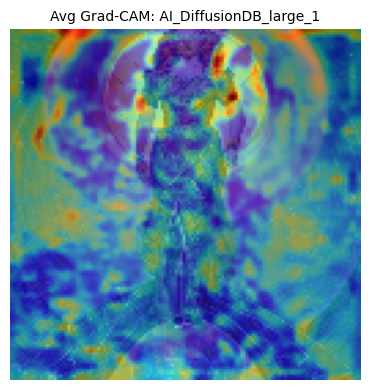

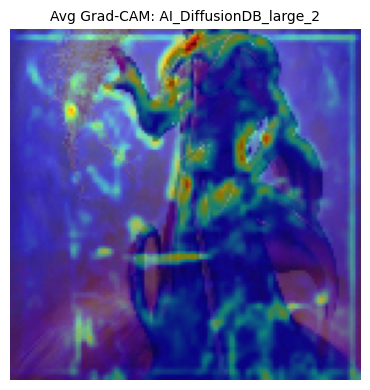

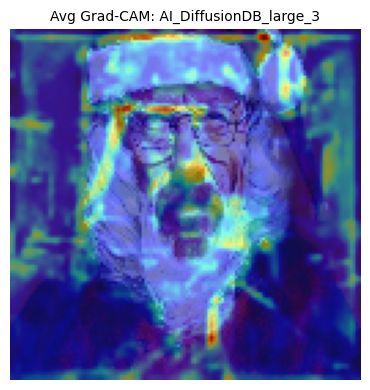

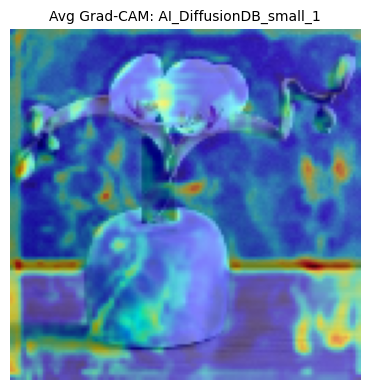

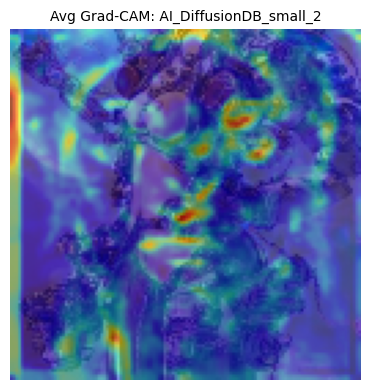

...

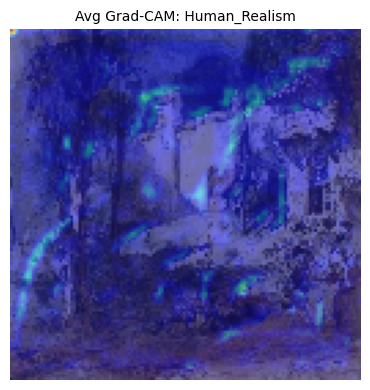

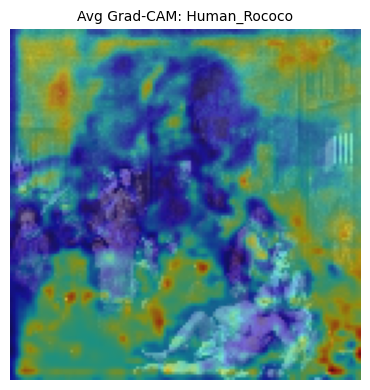

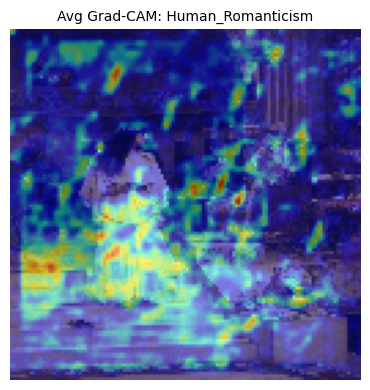

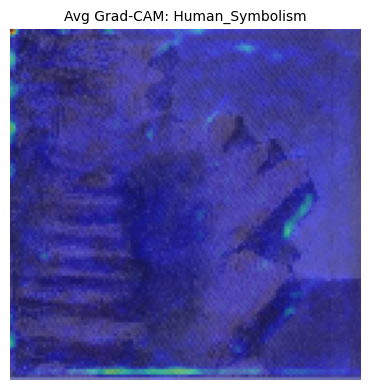

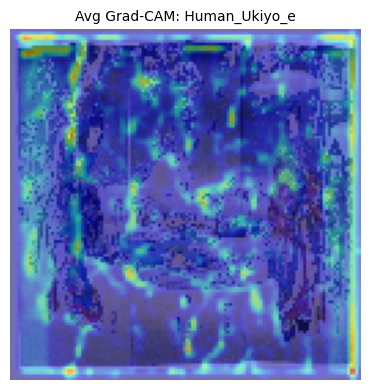

In [44]:
def make_gradcam(img, model, layer_name="conv2d_5"):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(layer_name).output, model.output]
    )
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img[None])
        pred_index = tf.argmax(predictions[0])
        loss = predictions[:, pred_index]
    grads = tape.gradient(loss, conv_outputs)[0]
    weights = tf.reduce_mean(grads, axis=(0, 1))
    cam = tf.reduce_sum(weights * conv_outputs[0], axis=-1)
    cam = np.maximum(cam, 0) / tf.reduce_max(cam)
    cam = tf.image.resize(cam[..., tf.newaxis], (128, 128)).numpy()
    return cam[..., 0]

# Compute average Grad-CAM for each style (using the 3 prototype images)
for style, imgs in style_prototypes.items():
    cams = [make_gradcam(img, flat_model) for img in imgs]
    avg_cam = np.mean(cams, axis=0)

    plt.figure(figsize=(4, 4))
    plt.imshow(imgs[0])
    plt.imshow(avg_cam, cmap='jet', alpha=0.5)
    plt.title(f"Avg Grad-CAM: {style}", fontsize=10)
    plt.axis("off")
    plt.tight_layout()
    plt.show()


##### Averaged Grad-CAM overlays highlight regions the model focuses on to identify each style. AI-generated art tends to trigger attention on smooth gradients or central composition, while Human styles invoke broader, texture-based activations across the canvas.


#### 10.5 (PCA projection)

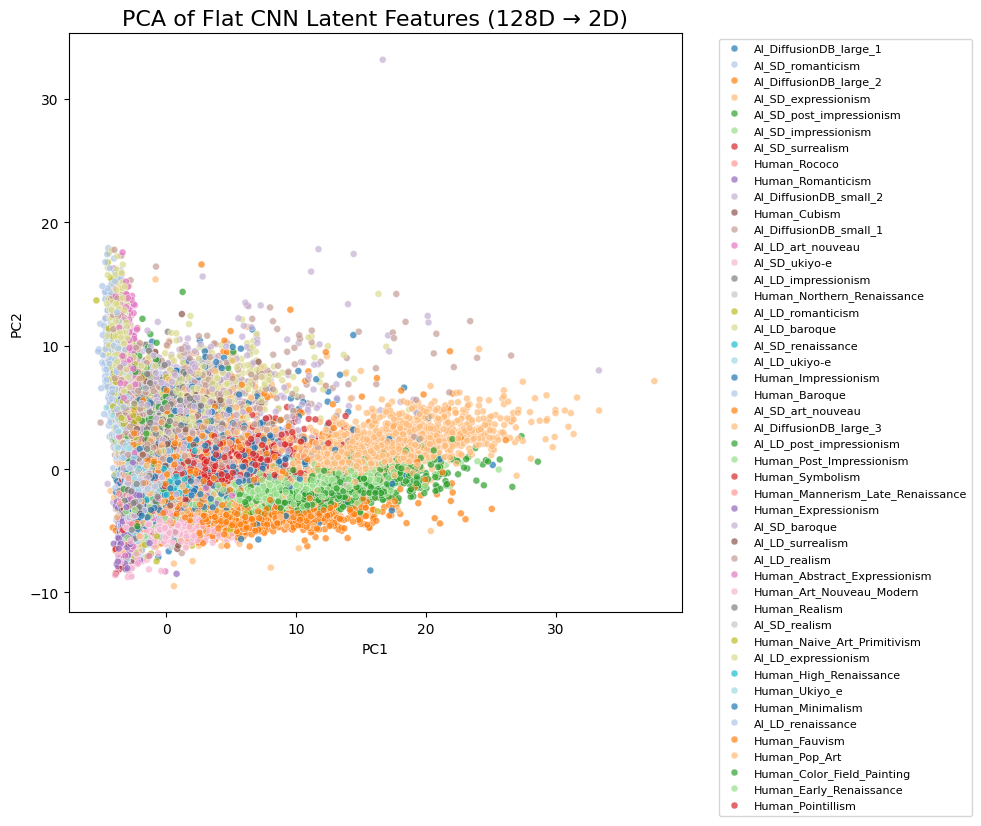

Explained variance ratio (Top 3 PCs): [0.34245294 0.22818309 0.09674689]


In [ ]:
from sklearn.decomposition import PCA

# Project the latent space into 2D using PCA
pca = PCA(n_components=3)
X_pca = pca.fit_transform(X_latent)

df_pca = pd.DataFrame({
    "PC1": X_pca[:, 0],
    "PC2": X_pca[:, 1],
    "style": [flat_filtered[i] for i in y_true]
})

plt.figure(figsize=(10, 8))
sns.scatterplot(data=df_pca, x="PC1", y="PC2", hue="style", palette="tab20", s=25, alpha=0.7)
plt.title("PCA of Flat CNN Latent Features (128D → 2D)", fontsize=16)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
plt.tight_layout()
plt.show()

# Print explained variance
print("Explained variance ratio (Top 3 PCs):", pca.explained_variance_ratio_)


#### 10.6 Conclusion - Latent Feature Analysis & Interpretability: Final Reflections

To conclude our investigation, we analyzed the internal representations learned by our flat multi-class CNN through a battery of interpretability tools: t-SNE and PCA projections, latent prototypes, and Grad-CAM overlays. This multi-faceted approach reveals not only how the model differentiates between 47 artistic styles, but also what specific visual cues—colors, forms, textures—it associates with each.

The resulting projection (Figure 10.2) vividly demonstrates that the model’s latent space organizes styles in a way that reflects their visual regularity. AI-generated styles like `AI_DiffusionDB_large_1`, `AI_SD_ukiyo-e`, and `AI_LD_expressionism` cluster tightly and cleanly, indicating consistent internal structure and low intra-class variance. For instance, `AI_SD_ukiyo-e`—an algorithmic mimicry of traditional Japanese woodblock printing—forms a distinct cluster in t-SNE space, showing that the model has latched onto its hallmark features: flat color planes, bold outlines, and compositions rich in negative space.

In contrast, **human-created art styles** appear more dispersed. Styles such as `Human_Expressionism` and `Human_Realism` overlap significantly with other human styles. This fuzziness in the latent space reflects the diversity, innovation, and cross-style hybridity found in human art, which makes sharp categorization more difficult. For example, human realism can range from 19th-century portraiture to modern hyperrealist techniques—visually diverse despite sharing a conceptual aim.

The **PCA projection** further supports this: while the first three principal components capture over 67% of the total variance, human styles are more spread out across the latent dimensions. `Human_Impressionism`, for instance, lies adjacent to both `Human_Post_Impressionism` and `AI_LD_impressionism`, indicating that the CNN detects shared stylistic traits like dappled light and loose brushwork regardless of origin. However, while the AI versions tend to form dense blobs, their human analogs are more distributed, confirming that **machine-generated styles are often more formulaic, while human creativity resists clean compression**.

Our **latent prototype images** offer further insight. For `AI_LD_art_nouveau`, the most representative samples showcase consistent traits: elegant, flowing lines, ornate frames, and female figures rendered with smooth gradients and pastel tones. The prototypes for `AI_LD_expressionism` highlight distorted facial structures and vibrant, sometimes clashing color palettes—an automated echo of the movement’s emphasis on subjective emotion and psychological depth. `AI_LD_realism` prototypes show polished portraits and interiors, with strong lighting and photographic clarity, revealing that the model associates this style with tonal balance and detail preservation. Notably, the human counterparts in each of these genres displayed far greater variation, further reinforcing the idea that **AI art emphasizes consistency while human art often thrives on deviation and nuance**.

Using **Grad-CAM**, we visualized the spatial attention of the model when making predictions. For `AI_DiffusionDB_large_1`, Grad-CAM overlays revealed that the model consistently focused on symmetrical bodies, ornamental halos, and stylized costumes—suggesting that these motifs are hallmarks of this generative series. In contrast, `AI_LD_expressionism` drew attention to irregular stroke patterns and expressive faces, mirroring human artistic intent. In human categories like `Human_Realism`, the model tended to focus on detailed facial features and object outlines, while in `Human_Impressionism`, the attention was more diffuse, likely reflecting the movement’s lack of sharp borders and focus on atmosphere.

These findings culminate in several **key insights**:

- **AI-generated art is easier to model and classify**, as it often follows clear stylistic templates and outputs with low intra-class variability. This is evidenced by the tight t-SNE clusters, sharp Grad-CAM focus, and consistent prototypes across multiple AI categories.
- **Human-made styles are more complex and fluid**, occupying overlapping regions in feature space, and demonstrating greater internal diversity. Even within a single style like `Human_Expressionism`, variations in color use, composition, and subject matter challenge the model's categorization.
- **The model learns more than surface-level cues**: it attends to compositional balance, brush texture, and regional details, not just global hue distributions. Grad-CAM shows that it is responsive to stylistically relevant features—such as the rough facial rendering in expressionism or ornate framing in art nouveau—not merely color histograms or edge contours.

In short, our CNN developed a **rich, semantically meaningful geometry of artistic style**, one that reflects both the precision of algorithmic generation and the organic ambiguity of human creativity. It captures not only *what* styles look like but *how* they are constructed—from brushstroke to palette, from focal point to background wash. This suggests promising future directions in both computational art history and AI-generated creative tools: using models not only to classify but to **explain, interpret, and even critique art through the lens of learned representations**.
